In [32]:
# Common
import os
import numpy as np
import pandas as pd
import tensorflow as tf
from IPython.display import clear_output as cls
import keras
import cv2
import shutil

# Data Loading
from tensorflow import io
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import load_img, img_to_array

# Data Visualization
import matplotlib
import matplotlib.pyplot as plt
import plotly.express as px

# Model 
from keras.layers import add
from keras.layers import Input
from keras.layers import Layer
from keras.layers import Dense
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Conv3D, MaxPooling3D
from keras.models import Sequential
from keras.layers import Flatten
from tensorflow.nn import gelu as GELU, softmax
from keras.layers import LayerNormalization as LN
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Activation, BatchNormalization
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras.models import Model
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import train_test_split
import sys

print('All modules have been imported')

All modules have been imported


In [33]:
data_path = r"C:\Users\Agathe\Documents\Projet_integrateur\Animal-Data-V2\Data-V2"
#data_path + r'\Validation Data'+ "\\" + folder

In [34]:
# train data
list_train = []
for folder in  os.listdir(data_path + r'\Training Data') : 
    for picture in os.listdir(data_path + r'\Training Data' + "\\" + folder) :
        if picture.endswith(".jpg") or picture.endswith(".jpeg") or picture.endswith(".png") :
            list_train.append(data_path + r'\Training Data' + "\\" + folder + "\\" + picture)
print(list_train)

['C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Training Data\\Cat\\Cat (10).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Training Data\\Cat\\Cat (10).jpg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Training Data\\Cat\\Cat (100).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Training Data\\Cat\\Cat (1000).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Training Data\\Cat\\Cat (1001).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Training Data\\Cat\\Cat (1002).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Training Data\\Cat\\Cat (1003).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Training Data\\Cat\\Cat (1004).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Training Data\\Ca

In [35]:
# valid data
list_valid = []
for folder in  os.listdir(data_path + r'\Validation Data') : 
    for picture in os.listdir(data_path + r'\Validation Data' + "\\" + folder) :
        if picture.endswith(".jpg") or picture.endswith(".jpeg") or picture.endswith(".png") :
            list_valid.append(data_path + r'\Validation Data' + "\\" + folder + "\\" + picture)
print(list_valid)

['C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (1).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (1).jpg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (1).png', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (10).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (10).jpg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (11).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (11).jpg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (12).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrat

In [36]:
# test data
list_test = []
for folder in  os.listdir(data_path + r'\Testing Data') : 
    for picture in os.listdir(data_path + r'\Testing Data' + "\\" + folder) :
        if picture.endswith(".jpg") or picture.endswith(".jpeg") or picture.endswith(".png") :
            list_valid.append(data_path + r'\Testing Data' + "\\" + folder + "\\" + picture)
print(list_valid)

['C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (1).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (1).jpg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (1).png', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (10).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (10).jpg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (11).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (11).jpg', 'C:\\Users\\Agathe\\Documents\\Projet_integrateur\\Animal-Data-V2\\Data-V2\\Validation Data\\Cat\\cat-valid (12).jpeg', 'C:\\Users\\Agathe\\Documents\\Projet_integrat

In [37]:
# Class Names
class_names = sorted(os.listdir(data_path + r'\Training Data'))
n_classes = len(class_names)

# Class Distribution
class_dis_train = [len(os.listdir(data_path + r'\Training Data'+ "\\" + folder)) for folder in class_names]

# Show
print(f"Total Number of Classes : {n_classes} \nClass Names : {class_names}")

Total Number of Classes : 10 
Class Names : ['Cat', 'Cow', 'Dog', 'Elephant', 'Gorilla', 'Hippo', 'Monkey', 'Panda', 'Tiger', 'Zebra']


In [38]:
# Visualize 
fig = px.pie(names=class_names, values=class_dis_train, title="Training Class Distribution", hole=0.4)
fig.update_layout({'title':{'x':0.48}})
fig.show()

# Visualize 
fig = px.bar(x=class_names, y=class_dis_train, title="Training Class Distribution", color=class_names)
fig.update_layout({'title':{'x':0.48}})
fig.show()

In [39]:
# Class Distribution
class_dis_valid = [len(os.listdir(data_path + r'\Validation Data'+ "\\" + folder)) for folder in class_names]

# Pie
fig = px.pie(names=class_names, values=class_dis_valid, title="Validation Class Distribution", color=class_names, hole=0.2)
fig.update_layout({'title':{'x':0.5}})
fig.show()

# Visualize 
fig = px.bar(x=class_names, y=class_dis_valid, color=class_names)
fig.show()

In [40]:
# Class Distribution
class_dis_test = [len(os.listdir(data_path + r'\Testing Data'+ "\\" + folder)) for folder in class_names]

# Pie
fig = px.pie(names=class_names, values=class_dis_test, title="Testing Class Distribution", color=class_names, hole=0.2)
fig.update_layout({'title':{'x':0.5}})
fig.show()

# Visualize 
fig = px.bar(x=class_names, y=class_dis_test, color=class_names)
fig.show()

In [41]:
code = {'Cat':0 ,'Cow':1,'Dog':2,'Elephant':3,'Gorilla':4,'Hippo':5,'Monkey':6,'Panda':7,'Tiger':8,'Zebra':9}
def getcode(n) : 
    for x , y in code.items() : 
        if n == y : 
            return x 

In [43]:
# Initialize the ImageDataGenerator
train_gen = ImageDataGenerator(rescale=1/255, rotation_range=10, horizontal_flip=True)
valid_gen = ImageDataGenerator(rescale=1/255)
test_gen = ImageDataGenerator(rescale=1/255)

#Load to visualize 
train_visualize = train_gen.flow_from_directory(data_path + r'\Training Data', class_mode='binary', target_size=(256,256), shuffle=True, batch_size=32)
valid_visualize = valid_gen.flow_from_directory(data_path + r'\Validation Data', class_mode='binary', target_size=(256,256), shuffle=True, batch_size=32) 
test_visualize = test_gen.flow_from_directory(data_path + r'\Testing Data', class_mode='binary', target_size=(256,256), shuffle=True, batch_size=32)

# Load Data
train_data = train_gen.flow_from_directory(data_path + r'\Training Data', target_size=(256,256, 256), color_mode="rgb", shuffle=True, batch_size=32, class_mode='categorical', classes = ['Cat', 'Cow', 'Dog', 'Elephant', 'Gorilla', 'Hippo', 'Monkey', 'Panda', 'Tiger', 'Zebra']) 
valid_data = valid_gen.flow_from_directory(data_path + r'\Validation Data', target_size=(256,256, 256), color_mode="rgb", shuffle=True, batch_size=32, class_mode='categorical', classes = ['Cat', 'Cow', 'Dog', 'Elephant', 'Gorilla', 'Hippo', 'Monkey', 'Panda', 'Tiger', 'Zebra']) 
test_data = test_gen.flow_from_directory(data_path + r'\Testing Data', target_size=(256,256, 256), color_mode="rgb", shuffle=False, batch_size=32, class_mode= None, classes = ['Cat', 'Cow', 'Dog', 'Elephant', 'Gorilla', 'Hippo', 'Monkey', 'Panda', 'Tiger', 'Zebra'])

Found 20000 images belonging to 10 classes.
Found 1000 images belonging to 10 classes.
Found 1907 images belonging to 10 classes.
Found 20000 images belonging to 10 classes.
Found 1000 images belonging to 10 classes.
Found 1907 images belonging to 10 classes.


In [44]:
def show_images(GRID=[5,5], model=None, size=(20,20), data=train_data):
    n_rows = GRID[0]
    n_cols = GRID[1]
    n_images = n_cols * n_rows
    
    i = 1
    plt.figure(figsize=size)
    for images, labels in data:
        id = np.random.randint(len(images))
        image, label = images[id], class_names[int(labels[id])]
        
        plt.subplot(n_rows, n_cols, i)
        plt.imshow(image)
        
        if model is None:
            title = f"Class : {label}"
        else:
            pred = class_names[int(np.argmax(model.predict(image[np.newaxis, ...])))]
            title = f"Org : {label}, Pred : {pred}"
            cls()
        
        plt.title(title)
        plt.axis('off')
        
        i+=1
        if i>=(n_images+1):
            break
            
    plt.tight_layout()
    plt.show()

In [45]:
def load_image(path):
    image = tf.cast(tf.image.resize(img_to_array(load_img(path))/255., (256,256)), tf.float32)
    return image
def show_image(image, title=None):
    plt.imshow(image)
    plt.axis('off')
    plt.title(title)

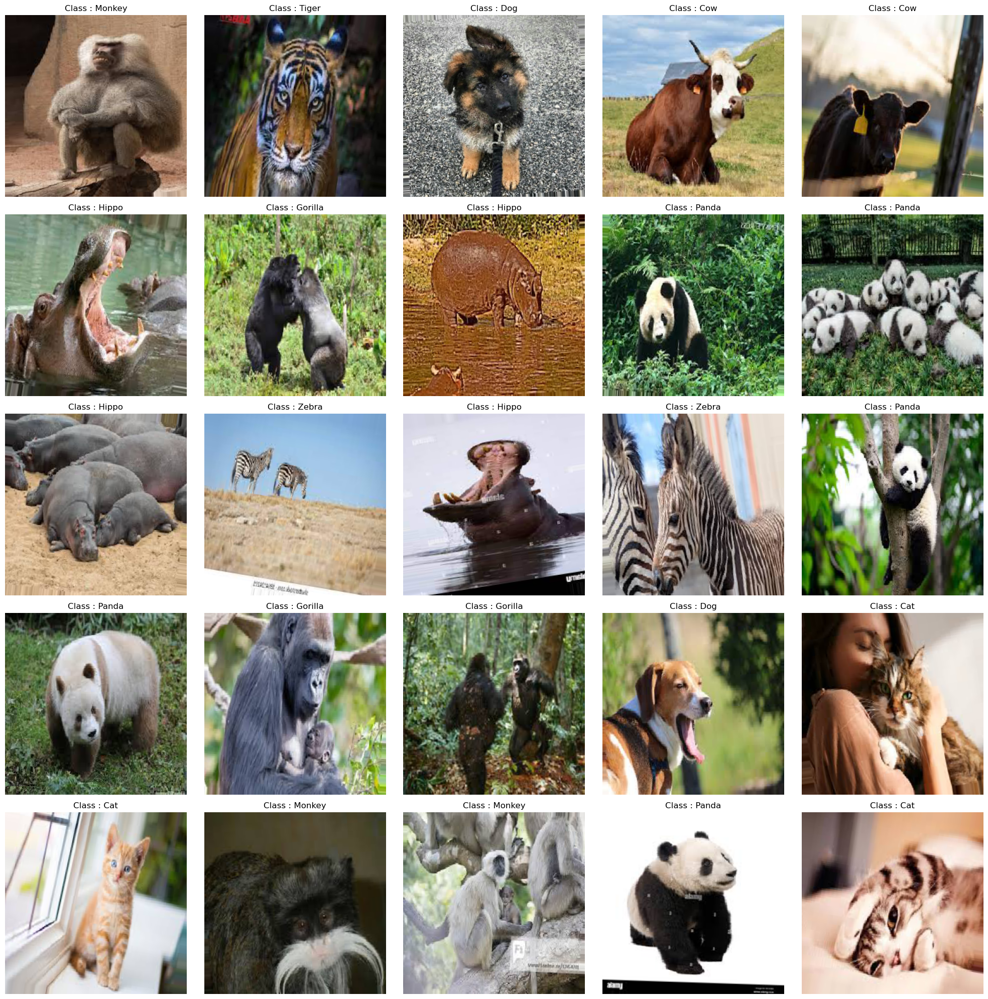

In [46]:
show_images(data=train_visualize)

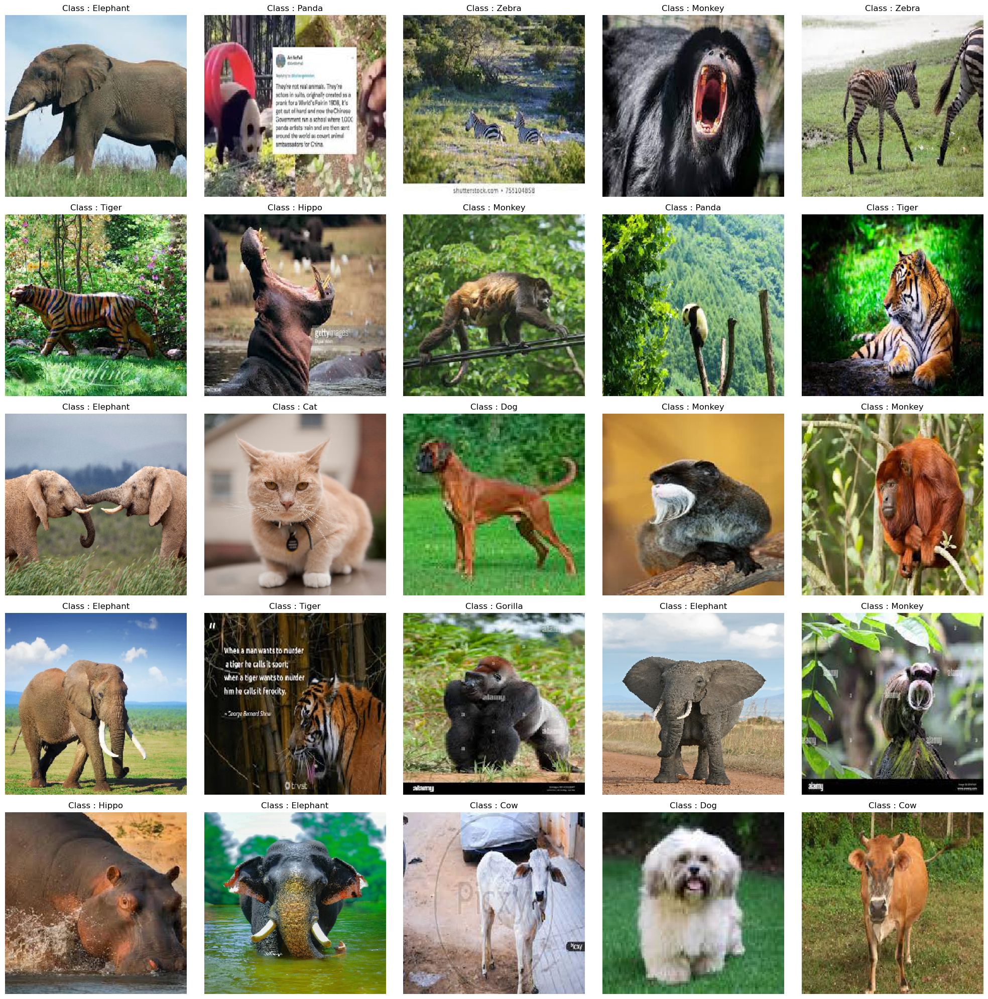

In [47]:
show_images(data=valid_visualize)

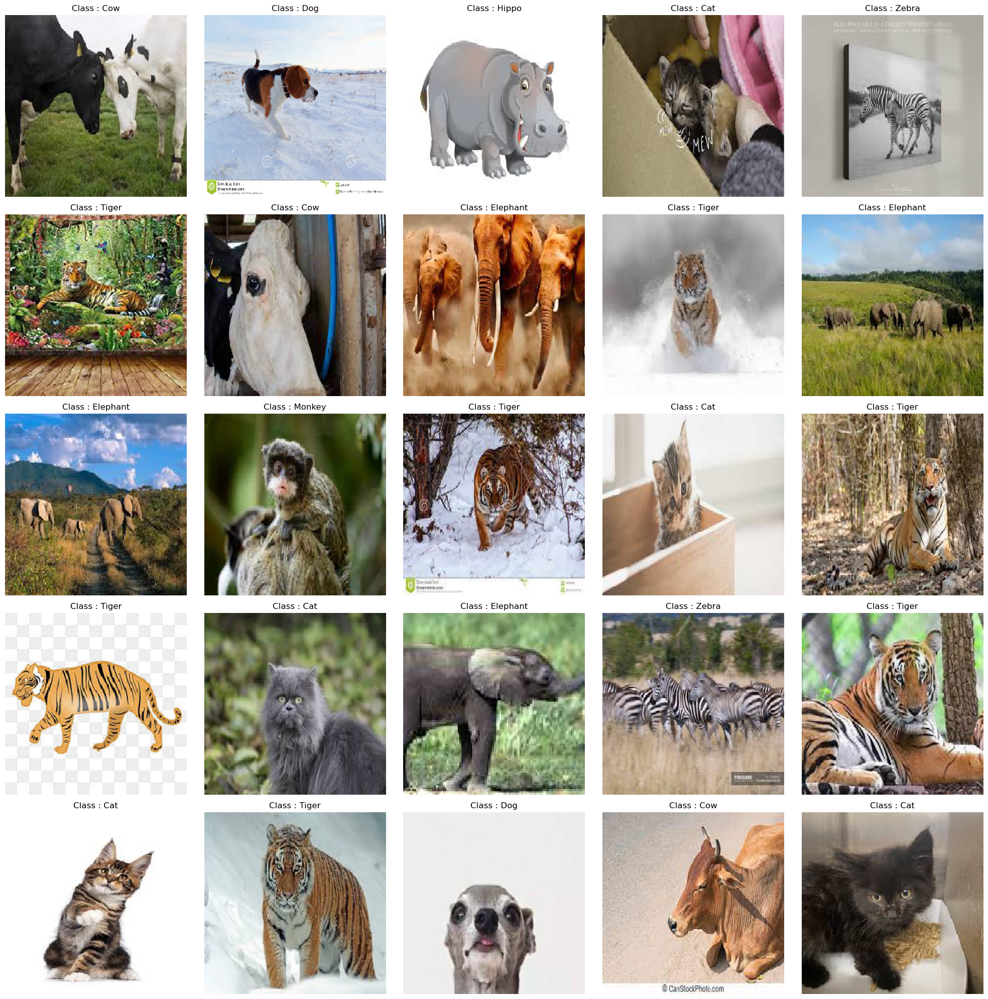

In [48]:
show_images(data=test_visualize)

In [50]:
# Define the CNN model
# model = keras.models.Sequential([
#     keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
#     keras.layers.MaxPooling2D((2, 2)),
#     keras.layers.Conv2D(64, (3, 3), activation='relu'),
#     keras.layers.MaxPooling2D((2, 2)),
#     keras.layers.Conv2D(128, (3, 3), activation='relu'),
#     keras.layers.MaxPooling2D((2, 2)),
#     keras.layers.Flatten(),
#     keras.layers.Dense(128, activation='relu'),
#     keras.layers.Dense(10, activation='softmax')
# ])

model = keras.models.Sequential([
    keras.layers.Conv3D(8, (3,3,3), activation='relu', input_shape=(256,256,256,3)),
    keras.layers.MaxPooling3D(pool_size=(2,2,2)),
    keras.layers.Conv3D(16, (3,3,3), activation='relu'),
    keras.layers.MaxPooling3D(pool_size=(2,2,2)),
    keras.layers.Flatten(),
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dense(10, activation='softmax')
])

ResourceExhaustedError: {{function_node __wrapped__StatelessRandomUniformV2_device_/job:localhost/replica:0/task:0/device:CPU:0}} OOM when allocating tensor with shape[3813248,64] and type float on /job:localhost/replica:0/task:0/device:CPU:0 by allocator cpu [Op:StatelessRandomUniformV2]

In [51]:
# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [52]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv3d (Conv3D)             (None, 254, 254, 254, 8)  656       
                                                                 
 max_pooling3d (MaxPooling3D  (None, 127, 127, 127, 8)  0        
 )                                                               
                                                                 
 conv3d_1 (Conv3D)           (None, 125, 125, 125, 16  3472      
                             )                                   
                                                                 
 max_pooling3d_1 (MaxPooling  (None, 62, 62, 62, 16)   0         
 3D)                                                             
                                                                 
 flatten (Flatten)           (None, 3813248)           0         
                                                        

In [31]:
# Train the model
model.fit_generator(
    generator=train_data,
    steps_per_epoch=100,
    epochs=5,
    validation_data=valid_data,
    validation_steps=50, 
    verbose = 1
)

C:\Users\Agathe\AppData\Local\Temp\ipykernel_4772\3425451552.py:2: UserWarning:

`Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.



MemoryError: Unable to allocate 6.00 GiB for an array with shape (32, 256, 256, 256, 3) and data type float32

In [21]:
# Évaluation du modèle sur les données de test
score = model.evaluate(valid_data, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Test loss: 2.3066041469573975
Test accuracy: 0.06400000303983688


In [26]:
predict=model.predict(test_data, verbose= 1)
predicted_class_indices=np.argmax(predict,axis=1)

60/60 [==============================] - 31s 511ms/step


In [27]:
model.save(r"C:\Users\Agathe\Documents\Projet_integrateur\Model_Test", save_format = 'tf')

INFO:tensorflow:Assets written to: C:\Users\Agathe\Documents\Projet_integrateur\Model_Test\assets


INFO:tensorflow:Assets written to: C:\Users\Agathe\Documents\Projet_integrateur\Model_Test\assets
